## Read Images

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision import transforms

image_size = 64
batch_size = 240
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
train_data = ImageFolder('../input/animefacedataset/',transform=transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(*stats)   
]))
train_data = DataLoader(train_data, batch_size, shuffle=True, num_workers=3, pin_memory=True)
# pin_memory: Host to GPU copies are much faster when they originate from pinned (page-locked) memory
print('Total batches:',len(train_data))

Total batches: 265


## Helper Functions

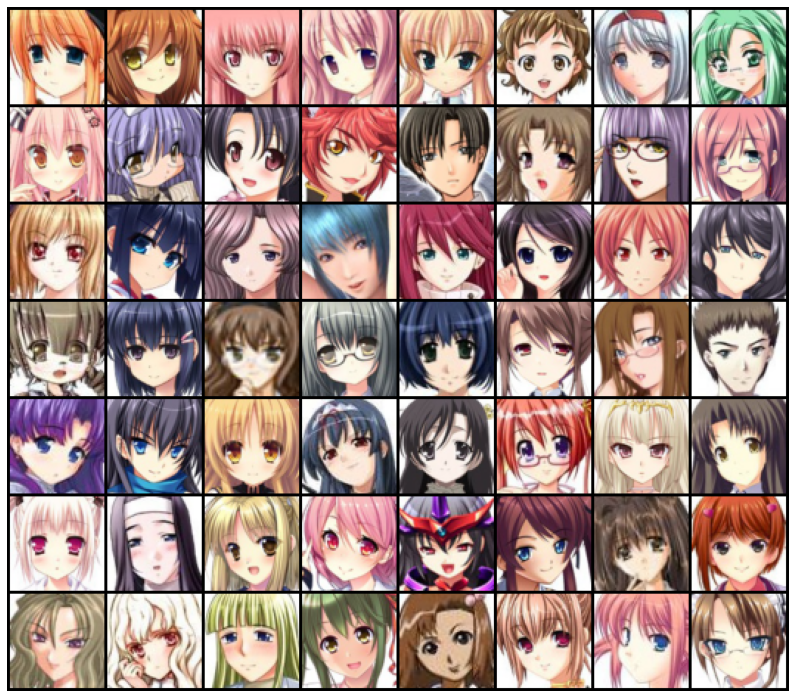

In [3]:
from torchvision.utils import make_grid

def denorm(img_batch):
    return img_batch * stats[1][0] + stats[0][0]
    # Rescale the normalised images to (0,1)
    
def images_preview(images):
    fig, ax = plt.subplots(figsize=(14, 14))
    ax.axis('off')
    ax.imshow(make_grid(denorm(images.cpu().detach()[:56]), nrow=8).permute(1, 2, 0))

def batch_preview(data):
    for images, _ in data:
        images_preview(images)
        break
        
os.makedirs('generated_faces', exist_ok=True)        
batch_preview(train_data)

### Functions for using gpu 

In [4]:
import torch

def get_device():
    # Pick GPU if available, else CPU
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    # Move to given device
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    # Wrap a dataloader to move data to a device
    def __init__(self, data, device):
        self.data = data
        self.device = device
        
    def __iter__(self):
        # Yield a batch of data after moving it to device
        for b in self.data: 
            yield to_device(b, self.device)

    def __len__(self):
        # Number of batches
        return len(self.data)

In [5]:
device = get_device()
device

device(type='cuda')

In [6]:
train_data = DeviceDataLoader(train_data,device)

## Model

### Discriminator

In [7]:
import torch.nn as nn

discriminator = nn.Sequential(
    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Flatten(),
    nn.Sigmoid())

In [8]:
discriminator = to_device(discriminator, device)
# moving to appropriate device

### Generator

In [9]:
noise_size = 128
generator = nn.Sequential(
    nn.ConvTranspose2d(noise_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
)

In [10]:
generator = to_device(generator, device)

## Training Step

### Discriminator

In [11]:
from torch.nn.functional import binary_cross_entropy

def train_disc(real_image_batch, disc_opt):
    disc_opt.zero_grad()
    real_pred = discriminator(real_image_batch)
    real_target = torch.ones(real_image_batch.size(0), 1, device=device)
    real_loss = binary_cross_entropy(real_pred, real_target)
    real_score = torch.mean(real_pred).item()
    noise = torch.randn(batch_size, noise_size, 1, 1, device=device)
    fake_image_batch = generator(noise)
    fake_target = torch.zeros(fake_image_batch.size(0), 1, device=device)
    fake_pred = discriminator(fake_image_batch)
    fake_loss = binary_cross_entropy(fake_pred, fake_target)
    fake_score = torch.mean(fake_pred).item()
    disc_loss = real_loss + fake_loss
    disc_loss.backward()
    disc_opt.step()
    return disc_loss.item(), real_score, fake_score    

### Generator

In [12]:
def train_gen(gen_opt):
    gen_opt.zero_grad()
    noise = torch.randn(batch_size, noise_size, 1, 1, device=device)
    fake_image_batch = generator(noise)
    pred = discriminator(fake_image_batch)
    target = torch.ones(batch_size, 1, device=device)
    gen_loss = binary_cross_entropy(pred, target)
    gen_loss.backward()
    gen_opt.step()
    return gen_loss.item()

## Save Images

In [13]:
fixed_noise = torch.randn(56, noise_size, 1, 1, device=device)

In [14]:
from torchvision.utils import save_image

def save_images(epoch,noise):
    fake_image_batch = generator(noise)
    fake_image_batch = denorm(fake_image_batch)
    save_image(fake_image_batch,os.path.join('generated_faces','face_{}.png'.format(epoch)),nrow=8)
    if epoch % 4 == 0 :
        fig, ax = plt.subplots(figsize=(14, 14))
        ax.axis('off')
        ax.imshow(make_grid(fake_image_batch.cpu().detach(), nrow=8).permute(1, 2, 0))

## Full Training

In [15]:
from tqdm.notebook import tqdm

def train(epochs, lr,):
    torch.cuda.empty_cache()
    disc_opt = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    gen_opt = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    for epoch in range(epochs):
        for real_image_batch, _ in tqdm(train_data):
            disc_loss, real_acc, fake_acc = train_disc(real_image_batch, disc_opt)
            gen_loss = train_gen(gen_opt)
        print("Epoch:{}/{}, gen_loss: {:.2f}, disc_loss:{:.2f}, real_acc:{:.2f}, fake_acc:{:.2f}".format(epoch+1, epochs, gen_loss, disc_loss, real_acc, fake_acc))
        save_images(epoch+1, fixed_noise)    

In [16]:
lr = 0.0002
epochs = 72

  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:1/72, gen_loss: 4.15, disc_loss:0.42, real_acc:0.83, fake_acc:0.18


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:2/72, gen_loss: 5.80, disc_loss:0.53, real_acc:0.87, fake_acc:0.28


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:3/72, gen_loss: 5.85, disc_loss:0.38, real_acc:0.92, fake_acc:0.24


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:4/72, gen_loss: 3.79, disc_loss:0.93, real_acc:0.48, fake_acc:0.01


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:5/72, gen_loss: 3.61, disc_loss:0.02, real_acc:0.99, fake_acc:0.01


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:6/72, gen_loss: 3.68, disc_loss:0.25, real_acc:0.88, fake_acc:0.09


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:7/72, gen_loss: 5.80, disc_loss:0.28, real_acc:0.91, fake_acc:0.14


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:8/72, gen_loss: 5.69, disc_loss:0.23, real_acc:0.92, fake_acc:0.12


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:9/72, gen_loss: 8.23, disc_loss:0.27, real_acc:0.96, fake_acc:0.19


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:10/72, gen_loss: 5.04, disc_loss:0.15, real_acc:0.92, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:11/72, gen_loss: 4.45, disc_loss:0.05, real_acc:0.99, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:12/72, gen_loss: 5.37, disc_loss:0.11, real_acc:0.99, fake_acc:0.09


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:13/72, gen_loss: 3.45, disc_loss:0.30, real_acc:0.81, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:14/72, gen_loss: 8.56, disc_loss:0.45, real_acc:0.95, fake_acc:0.27


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:15/72, gen_loss: 4.19, disc_loss:0.18, real_acc:0.89, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:16/72, gen_loss: 3.89, disc_loss:0.17, real_acc:0.89, fake_acc:0.03


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:17/72, gen_loss: 4.97, disc_loss:0.17, real_acc:0.87, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:18/72, gen_loss: 7.31, disc_loss:0.26, real_acc:0.99, fake_acc:0.19


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:19/72, gen_loss: 4.74, disc_loss:0.16, real_acc:0.92, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:20/72, gen_loss: 5.47, disc_loss:0.22, real_acc:0.95, fake_acc:0.14


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:21/72, gen_loss: 6.17, disc_loss:0.18, real_acc:0.96, fake_acc:0.11


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:22/72, gen_loss: 4.39, disc_loss:0.14, real_acc:0.94, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:23/72, gen_loss: 3.68, disc_loss:0.19, real_acc:0.89, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:24/72, gen_loss: 4.17, disc_loss:0.11, real_acc:0.93, fake_acc:0.03


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:25/72, gen_loss: 4.97, disc_loss:0.19, real_acc:0.93, fake_acc:0.09


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:26/72, gen_loss: 5.64, disc_loss:0.09, real_acc:0.99, fake_acc:0.07


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:27/72, gen_loss: 5.01, disc_loss:0.08, real_acc:0.98, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:28/72, gen_loss: 3.52, disc_loss:0.05, real_acc:0.99, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:29/72, gen_loss: 4.88, disc_loss:0.18, real_acc:0.93, fake_acc:0.08


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:30/72, gen_loss: 5.37, disc_loss:0.11, real_acc:0.97, fake_acc:0.07


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:31/72, gen_loss: 3.46, disc_loss:0.34, real_acc:0.84, fake_acc:0.10


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:32/72, gen_loss: 4.40, disc_loss:0.06, real_acc:0.97, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:33/72, gen_loss: 5.42, disc_loss:0.16, real_acc:0.97, fake_acc:0.10


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:34/72, gen_loss: 2.44, disc_loss:0.22, real_acc:0.84, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:35/72, gen_loss: 4.29, disc_loss:0.09, real_acc:0.96, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:36/72, gen_loss: 4.55, disc_loss:0.10, real_acc:0.96, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:37/72, gen_loss: 13.75, disc_loss:1.16, real_acc:1.00, fake_acc:0.60


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:38/72, gen_loss: 5.51, disc_loss:0.09, real_acc:0.98, fake_acc:0.07


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:39/72, gen_loss: 3.79, disc_loss:0.20, real_acc:0.87, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:40/72, gen_loss: 4.50, disc_loss:0.13, real_acc:0.94, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:41/72, gen_loss: 4.72, disc_loss:0.10, real_acc:0.96, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:42/72, gen_loss: 4.51, disc_loss:0.06, real_acc:0.95, fake_acc:0.01


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:43/72, gen_loss: 3.14, disc_loss:0.39, real_acc:0.80, fake_acc:0.09


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:44/72, gen_loss: 4.39, disc_loss:0.08, real_acc:0.96, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:45/72, gen_loss: 4.52, disc_loss:0.15, real_acc:0.89, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:46/72, gen_loss: 4.34, disc_loss:0.16, real_acc:0.92, fake_acc:0.06


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:47/72, gen_loss: 5.30, disc_loss:0.11, real_acc:0.98, fake_acc:0.07


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:48/72, gen_loss: 6.77, disc_loss:0.63, real_acc:0.99, fake_acc:0.37


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:49/72, gen_loss: 4.63, disc_loss:0.06, real_acc:0.96, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:50/72, gen_loss: 4.97, disc_loss:0.08, real_acc:0.97, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:51/72, gen_loss: 5.07, disc_loss:0.06, real_acc:0.96, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:52/72, gen_loss: 4.09, disc_loss:0.16, real_acc:0.91, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:53/72, gen_loss: 4.14, disc_loss:0.07, real_acc:0.94, fake_acc:0.01


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:54/72, gen_loss: 6.16, disc_loss:0.05, real_acc:0.99, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:55/72, gen_loss: 4.19, disc_loss:0.08, real_acc:0.97, fake_acc:0.04


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:56/72, gen_loss: 6.34, disc_loss:0.17, real_acc:0.86, fake_acc:0.00


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:57/72, gen_loss: 3.94, disc_loss:0.08, real_acc:0.94, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:58/72, gen_loss: 4.91, disc_loss:0.05, real_acc:0.98, fake_acc:0.03


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:59/72, gen_loss: 6.04, disc_loss:0.08, real_acc:0.98, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:60/72, gen_loss: 3.74, disc_loss:0.11, real_acc:0.93, fake_acc:0.03


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:61/72, gen_loss: 4.53, disc_loss:0.05, real_acc:0.97, fake_acc:0.03


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:62/72, gen_loss: 5.21, disc_loss:0.08, real_acc:0.95, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:63/72, gen_loss: 4.49, disc_loss:0.07, real_acc:0.96, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:64/72, gen_loss: 0.46, disc_loss:0.34, real_acc:0.75, fake_acc:0.00


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:65/72, gen_loss: 0.47, disc_loss:0.23, real_acc:0.88, fake_acc:0.07


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:66/72, gen_loss: 4.79, disc_loss:0.06, real_acc:0.96, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:67/72, gen_loss: 0.18, disc_loss:1.19, real_acc:0.41, fake_acc:0.00


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:68/72, gen_loss: 3.63, disc_loss:0.14, real_acc:0.90, fake_acc:0.01


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:69/72, gen_loss: 7.19, disc_loss:0.16, real_acc:0.99, fake_acc:0.12


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:70/72, gen_loss: 4.81, disc_loss:0.06, real_acc:0.97, fake_acc:0.02


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:71/72, gen_loss: 3.82, disc_loss:0.13, real_acc:0.94, fake_acc:0.05


  0%|          | 0/265 [00:00<?, ?it/s]

Epoch:72/72, gen_loss: 3.16, disc_loss:0.27, real_acc:0.84, fake_acc:0.05


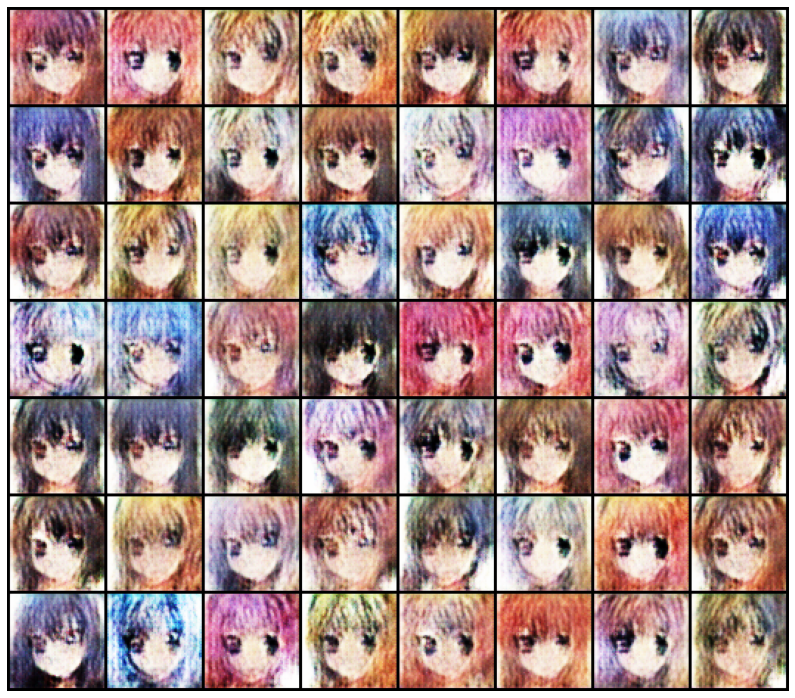

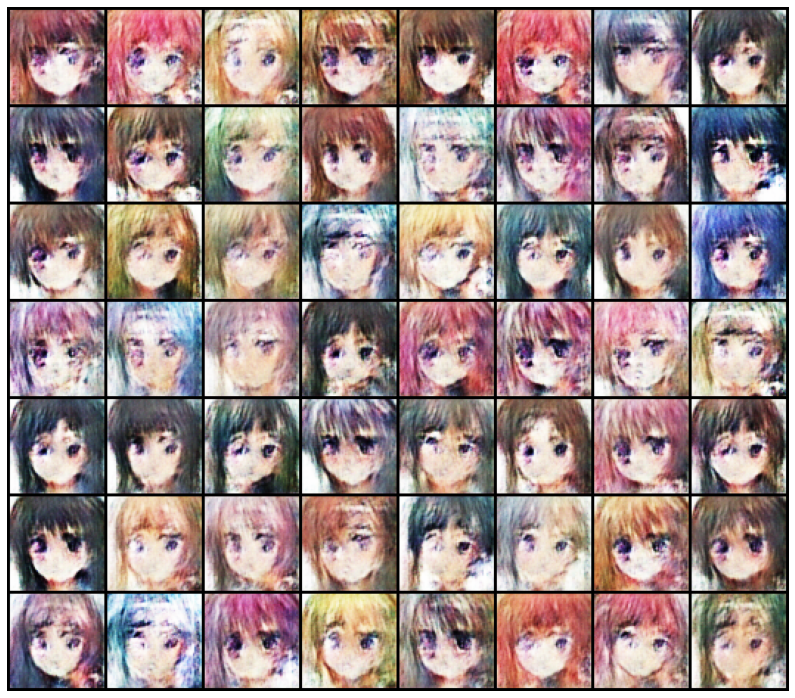

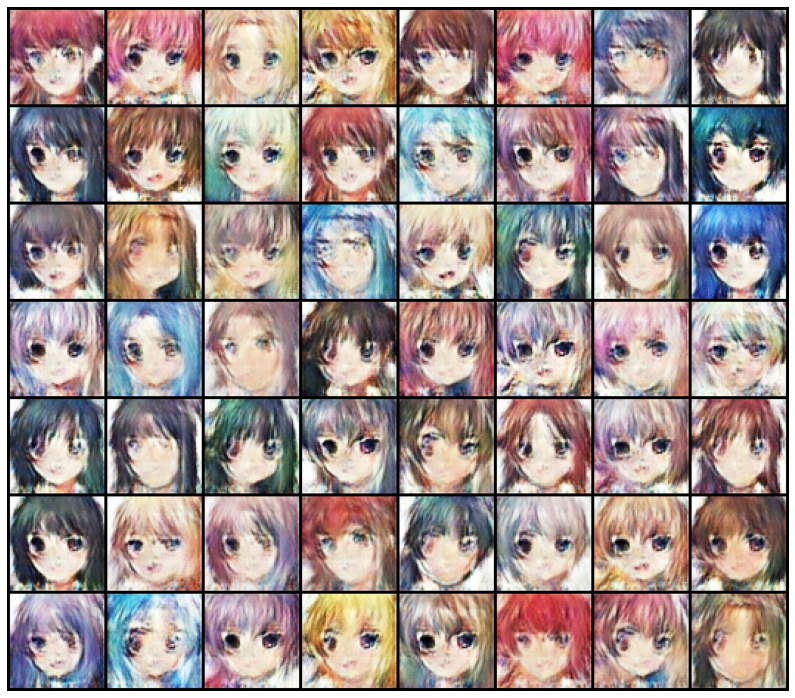

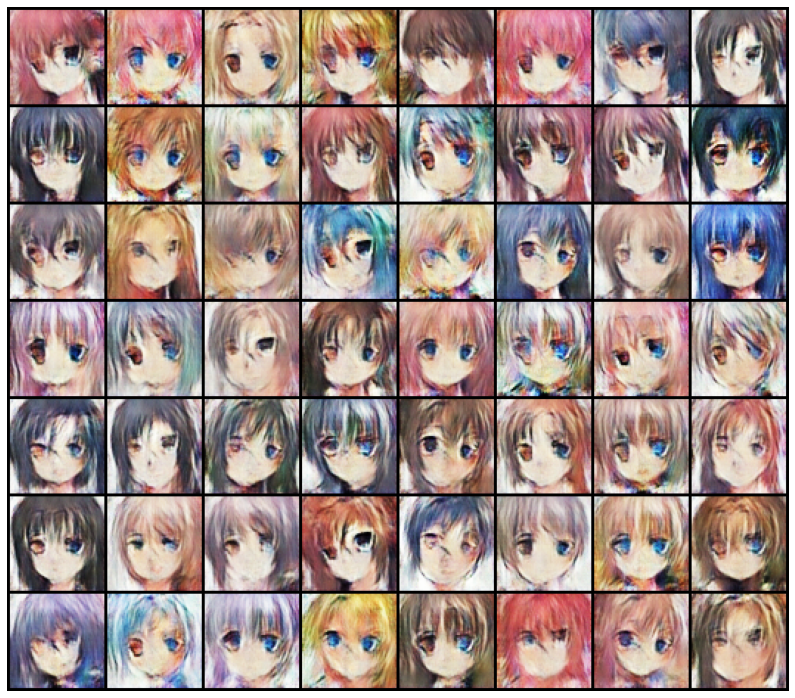

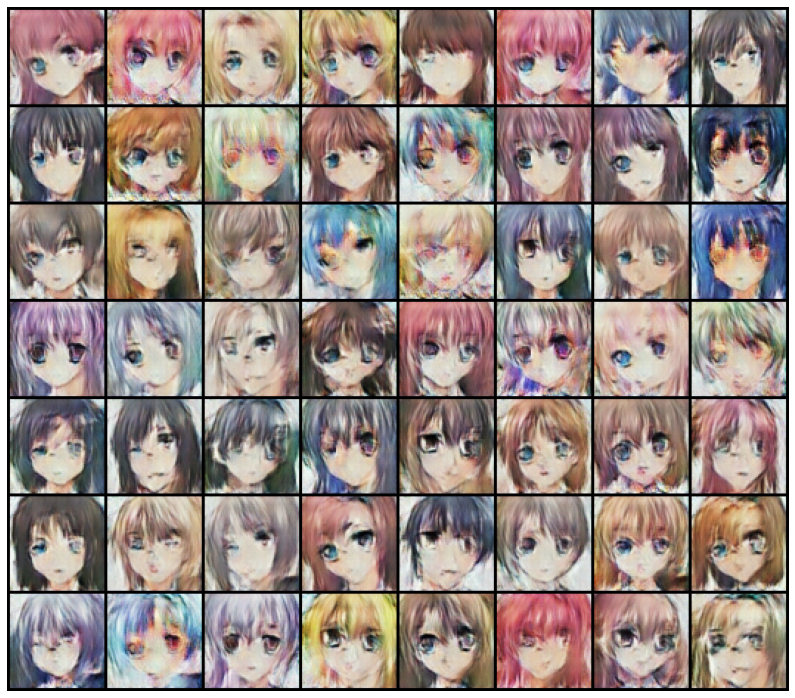

...

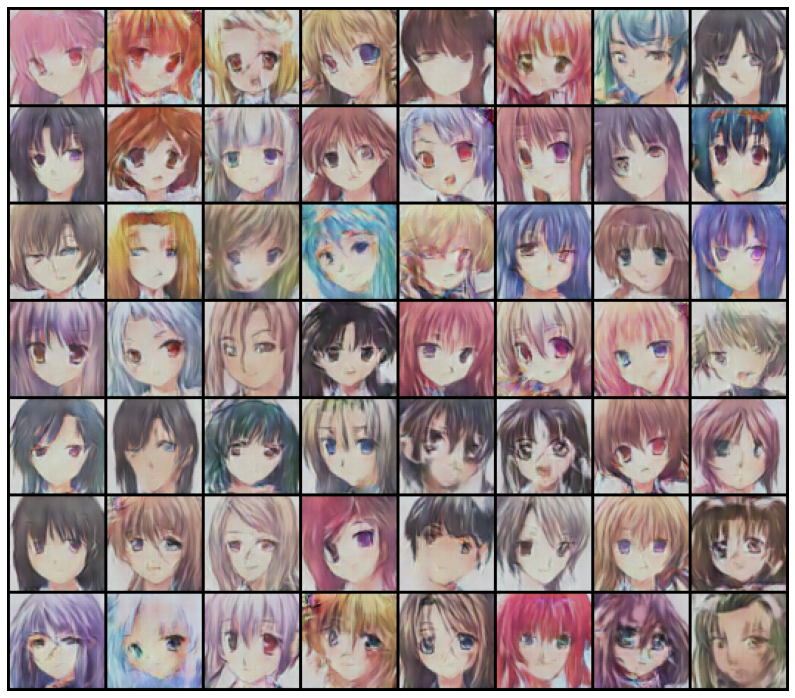

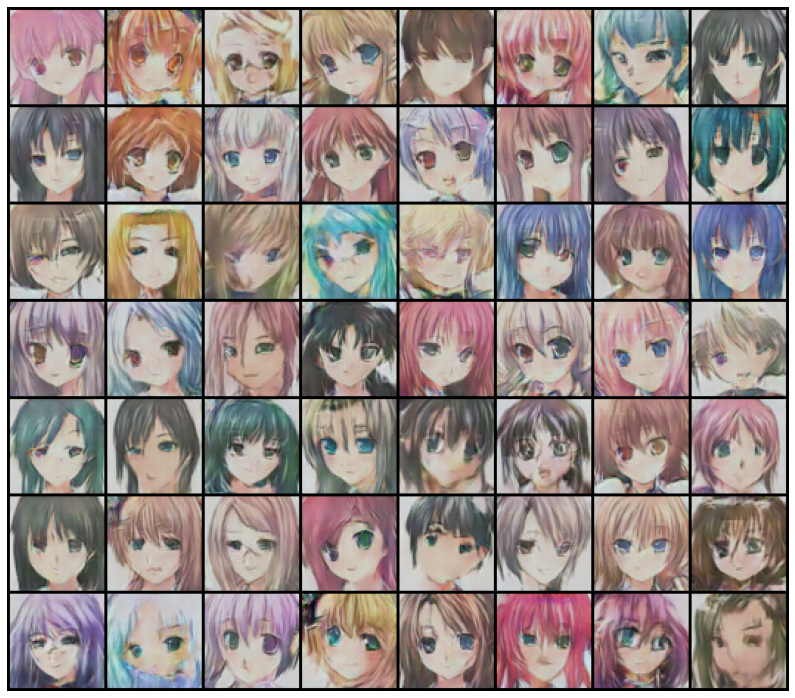

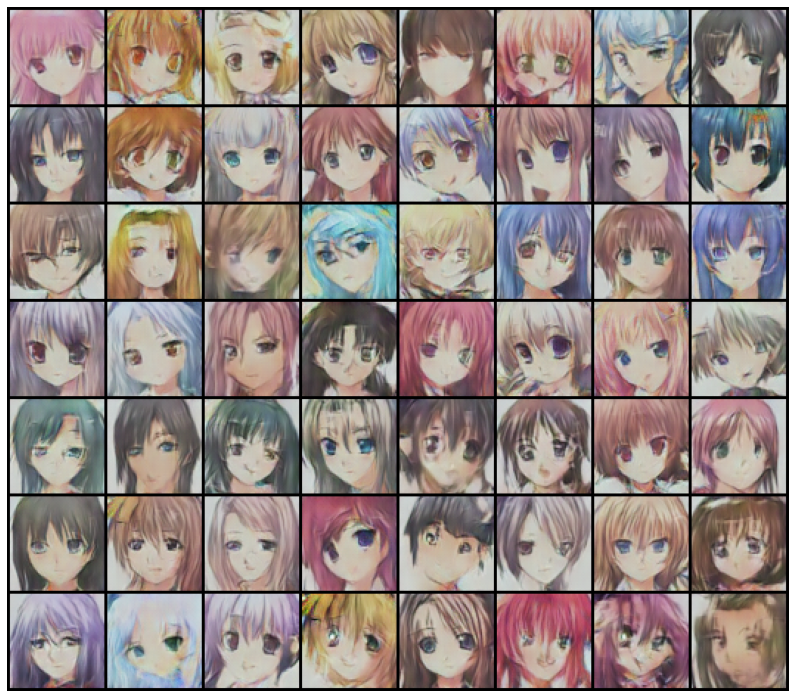

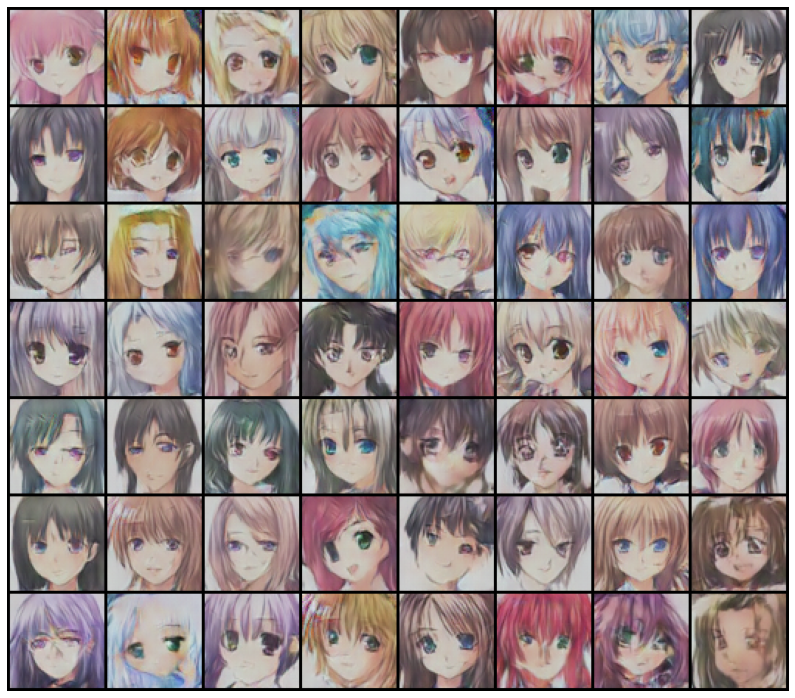

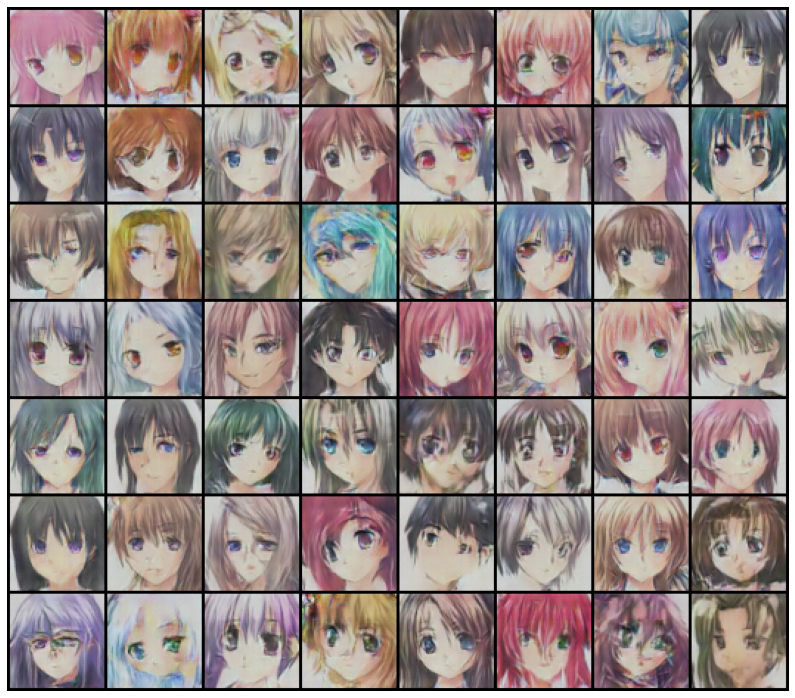

In [17]:
train(epochs, lr)